In [ ]:
import os
import numpy as np
import IPython
import copy
from shutil import copyfile

import tensorflow as tf
from tensorflow.contrib.learn.python.learn.datasets import base

import sys
sys.dont_write_bytecode=True

PACKAGE_PARENT = '../'
SCRIPT_DIR = os.path.dirname(os.path.realpath(os.path.join(os.getcwd(), os.path.expanduser('__file__'))))
sys.path.append(os.path.normpath(os.path.join(SCRIPT_DIR, PACKAGE_PARENT)))

from influence.inceptionModel import BinaryInceptionModel
from influence.logisticRegressionWithLBFGS import LogisticRegressionWithLBFGS
import influence.experiments
from influence.dataset import DataSet
# from influence.dataset_poisoning import iterative_attack, select_examples_to_attack, get_projection_to_box_around_orig_point, generate_inception_features
from influence.iter_attack import iterative_attack, select_examples_to_attack, get_projection_to_box_around_orig_point, generate_inception_features
from influence.Progress import *

from load_animals import *

from skimage import io

%load_ext autoreload
%autoreload 2


Using TensorFlow backend.


In [ ]:
img_side = 299
num_channels = 3
 
initial_learning_rate = 0.001 
keep_probs = None
decay_epochs = [1000, 10000]

weight_decay = 0.001

num_classes = 3
max_lbfgs_iter = 1000

# num_train_ex = 1800
# num_test_ex = 600
# batch_size = 100

# dataset_name = 'dogfish_%s_%s' % (num_train_ex, num_test_ex)
# # data_sets = load_animals(
# #     num_train_ex_per_class=num_train_ex_per_class, 
# #     num_test_ex_per_class=num_test_ex_per_class,
# #     classes=['dog', 'fish'])
# # data_sets = load_dogfish_with_orig_and_koda()
# # X, Y = load_koda()
# # print(X.shape, Y.shape)
# data_sets = new_load_dogfish_with_koda(num_train_ex, num_test_ex)

num_train_ex_per_class = 500
num_test_ex_per_class = 50
batch_size = 50

dataset_name = '_multiclass_%s_%s' % (num_train_ex_per_class, num_test_ex_per_class)
# extract_and_rename_animals()
data_sets = load_animals(
    num_train_ex_per_class=num_train_ex_per_class, 
    num_test_ex_per_class=num_test_ex_per_class,
#     classes=['Eagle', 'Komodo_Dragon', 'Snail', 'Ox', 'Mushroom'])
    classes=['Eagle', 'Snail', 'ox'])

np.random.seed()

full_graph = tf.Graph()
top_graph = tf.Graph()

def render_img(img):
    img_copy = np.copy(img)
    img_copy /= 2
    img_copy += 0.5
    io.imshow(img_copy)

Reading animals from raw images...
class: Eagle
../../5classes/Eagle/Eagle_0.JPEG
not found
../../5classes/Eagle/Eagle_1.JPEG
not found
../../5classes/Eagle/Eagle_2.JPEG
not found
../../5classes/Eagle/Eagle_3.JPEG
not found
../../5classes/Eagle/Eagle_4.JPEG
not found
../../5classes/Eagle/Eagle_5.JPEG
not found
../../5classes/Eagle/Eagle_6.JPEG
not found
../../5classes/Eagle/Eagle_7.JPEG
not found
../../5classes/Eagle/Eagle_8.JPEG
not found
../../5classes/Eagle/Eagle_9.JPEG
not found
../../5classes/Eagle/Eagle_10.JPEG
not found
../../5classes/Eagle/Eagle_11.JPEG
not found
../../5classes/Eagle/Eagle_12.JPEG
not found
../../5classes/Eagle/Eagle_13.JPEG
not found
../../5classes/Eagle/Eagle_14.JPEG
not found
../../5classes/Eagle/Eagle_15.JPEG
not found
../../5classes/Eagle/Eagle_16.JPEG
not found
../../5classes/Eagle/Eagle_17.JPEG
not found
../../5classes/Eagle/Eagle_18.JPEG
not found
../../5classes/Eagle/Eagle_19.JPEG
not found
../../5classes/Eagle/Eagle_20.JPEG
not found
../../5classes/Ea

In [ ]:
print('*** Full:')
with full_graph.as_default():
    full_model_name = '%s_inception_wd-%s' % (dataset_name, weight_decay)
    full_model = BinaryInceptionModel(
        img_side=img_side,
        num_channels=num_channels,
        weight_decay=weight_decay,
        num_classes=num_classes, 
        batch_size=batch_size,
        data_sets=data_sets,
        initial_learning_rate=initial_learning_rate,
        keep_probs=keep_probs,
        decay_epochs=decay_epochs,
        mini_batch=True,
        train_dir='output',
        log_dir='log',
        model_name=full_model_name)
    
    for data_set, label in [
        (data_sets.train, 'train'),
        (data_sets.test, 'test')]:

        inception_features_path = 'output/%s_inception_features_new_%s.npz' % (dataset_name, label)
        if not os.path.exists(inception_features_path):

            print('Inception features do not exist. Generating %s...' % label)
            data_set.reset_batch()
            
            num_examples = data_set.num_examples
#             assert num_examples % batch_size == 0

            inception_features_val = generate_inception_features(
                full_model, 
                data_set.x, 
                data_set.labels, 
                batch_size=batch_size)
            
            np.savez(
                inception_features_path, 
                inception_features_val=inception_features_val,
                labels=data_set.labels)
            
train_f = np.load('output/%s_inception_features_new_train.npz' % dataset_name)
inception_X_train = DataSet(train_f['inception_features_val'], train_f['labels'])
test_f = np.load('output/%s_inception_features_new_test.npz' % dataset_name)
inception_X_test = DataSet(test_f['inception_features_val'], test_f['labels'])

validation = None

inception_data_sets = base.Datasets(train=inception_X_train, validation=validation, test=inception_X_test)

print('*** Top:')
with top_graph.as_default():
    top_model_name = '%s_inception_onlytop_wd-%s' % (dataset_name, weight_decay)
    input_dim = 2048
    top_model = LogisticRegressionWithLBFGS(
        input_dim=input_dim,
        weight_decay=weight_decay,
        max_lbfgs_iter=max_lbfgs_iter,
        num_classes=num_classes, 
        batch_size=batch_size,
        data_sets=inception_data_sets,
        initial_learning_rate=initial_learning_rate,
        keep_probs=keep_probs,
        decay_epochs=decay_epochs,
        mini_batch=False,
        train_dir='output',
        log_dir='log',
        model_name=top_model_name)
    weights = top_model.retrain_and_get_weights(inception_X_train.x, inception_X_train.labels)
    orig_weight_path = 'output/inception_weights_%s.npy' % top_model_name
    np.save(orig_weight_path, weights)
    
with full_graph.as_default():
    full_model.load_weights_from_disk(orig_weight_path, do_save=False, do_check=True)

### Create poisoned dataset
print('Creating poisoned dataset...')

step_size = 0.02
print('step_size is', step_size)

num_train = len(data_sets.train.labels)
num_test = len(data_sets.test.labels)
max_num_to_poison = 10

### Try attacking each test example individually

# orig_X_train = np.copy(data_sets.train.x)
# orig_Y_train = np.copy(data_sets.train.labels)

test_indices_to_attack = [15, 6, 23]


for test_idx in test_indices_to_attack:

    print('****** Attacking test_idx %s ******' % test_idx)
    test_description = test_idx

    # If this has already been successfully attacked, skip
    filenames = [filename for filename in os.listdir('./output') if (
        (('%s_attack_testidx-%s_trainidx-' % (full_model.model_name, test_description)) in filename) and        
        (filename.endswith('stepsize-%s_proj_final.npz' % step_size)))]
        # and (('stepsize-%s_proj_final.npz' % step_size) in filename))] # Check all step sizes        
    if len(filenames) > 0:
        print('test_idx %s has already been successfully attacked. Skipping...')
        continue
        
    # Use top model to quickly generate inverse HVP
#     dup_incep = DataSet(np.copy(inception_X_test.x), np.copy(inception_X_test.labels))
#     dup_incep.labels[test_idx] = 0

    with top_graph.as_default():
        get_hvp(
            top_model,
            inception_X_test, inception_X_train,
            test_description=test_description,
            test_idx = [test_idx],
            force_refresh=True)
    copyfile(
        'output/%s-test-%s.npz' % (top_model_name, test_description),
        'output/%s-test-%s.npz' % (full_model_name, test_description))
        
    # Use full model to select indices to poison
    with full_graph.as_default():
        grad_influence_wrt_input_val_subset = get_grad_of_influence_wrt_input(full_model, 
                                                    [test_idx], data_sets.test, 
                                                    np.arange(num_train), data_sets.train, 
                                                    test_description,
                                                    force_refresh=False)
        # save into file for caching 
        print("finished calculating grad_wrt_input_val")
        pred_diff = np.sum(np.abs(grad_influence_wrt_input_val_subset), axis = 1)
        all_indices_to_poison = np.argsort(pred_diff)[-1:-max_num_to_poison-1:-1]
#     all_indices_to_poison =  [1141,1454,1447,158,306,1484,1589,1354,721,1295]
    print("-----------------------")
    print("-----------------------")
    print("all_indices_to_poison: ", all_indices_to_poison)
    # for 15: 999,  172, 1302,  492, 1446,  164,  153, 1186,   47,  575

    for num_to_poison in [0.1]:
        # If we're just attacking one training example, try attacking the first one and also the second one separately
        if num_to_poison == 0.1:
#             indices_to_poison = all_indices_to_poison[0:1]
            indices_to_poison = all_indices_to_poison[0:1]
            print('indices_to_poison', indices_to_poison)
        elif num_to_poison == 1.2:
            indices_to_poison = all_indices_to_poison[1:2]
        else:
            indices_to_poison = all_indices_to_poison[:num_to_poison]
        
        orig_X_train_subset = np.copy(data_sets.train.x[indices_to_poison, :])
        orig_X_train_inception_features_subset = np.copy(inception_X_train.x[indices_to_poison, :])

        project_fn = get_projection_to_box_around_orig_point(orig_X_train_subset, box_radius_in_pixels=0.5)

        attack_success = iterative_attack(top_model, full_model, top_graph, full_graph, project_fn, 
                                          [test_idx], 
                                          test_description, 
                                          data_sets.train, data_sets.test, dataset_name,
                                          indices_to_poison=indices_to_poison,
                                          num_iter=100,
                                          step_size=step_size,
                                          save_iter=100,
                                          early_stop=0.5,
#                                           target_labels=[0]
                                            )
        new_incep_feat = inception_X_train.x[indices_to_poison, :]
        with full_graph.as_default():
            data_sets.train.x[indices_to_poison, :] = orig_X_train_subset
            full_model.load_weights_from_disk(orig_weight_path, do_save=False, do_check=False)
        with top_graph.as_default():
            inception_X_train.x[indices_to_poison, :] = orig_X_train_inception_features_subset
            top_model.retrain_and_get_weights(inception_X_train.x, inception_X_train.labels)

#         if attack_success:
#             break

In [ ]:
print(min(data_sets.train.x[0]))
print(max(data_sets.train.x[0]))

(299, 299, 3)


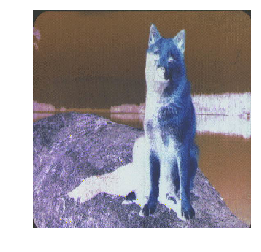

In [17]:
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import numpy as np

img = data_sets.test.x[179].reshape((img_side,img_side,num_channels)).copy()
plt.axis('off')
print(img.shape)
img /= 2
img += 0.5
img *= 255.

plt.imshow(np.array(img).reshape(img_side,img_side,3))
plt.show()

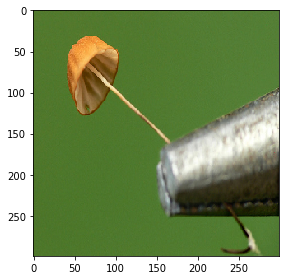

In [30]:
img = data_sets.train.x[706].reshape((img_side,img_side,num_channels)).copy()
render_img(img)

In [17]:
data_sets.test.x.shape

(150, 268203)

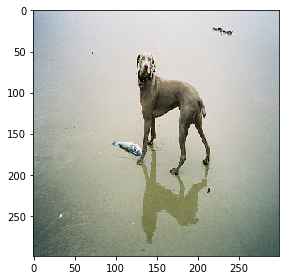

In [50]:
# render_img(attack_success)
img_attack = attack_success.reshape((img_side,img_side,num_channels))
render_img(img_attack)
print()

In [58]:
from keras.preprocessing import image

img2 = image.load_img("../../5classes/n01608432/n01608432_10016.JPEG")
img2.size

(500, 334)

In [56]:
img.size

(299, 299)

In [65]:
print(grad_influence_wrt_input_val_subset.shape)
pred_diff = np.sum(np.abs(grad_influence_wrt_input_val_subset), axis = 1)
indices_to_poison = np.argsort(pred_diff)[-1:-max_num_to_poison-1:-1]
print(indices_to_poison)

(1500, 268203)
[ 698 1323  647  462  665  723  232  706  420 1143]


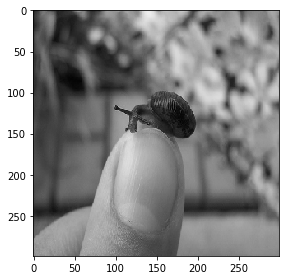

In [36]:
# for 15: 999,  172, 1302,  492, 1446,  164,  153, 1186,   47,  575
# 15, 6, 23
x = data_sets.train.x[999]
# x = data_sets.train.x[1446]
# 999,  709, 1446
render_img(x.reshape((img_side,img_side,num_channels)))

In [10]:
max(data_sets.train.labels)

2.0

In [4]:
data_sets.train.x.shape

(1500, 268203)

In [7]:
np.load(orig_weight_path)

array(None, dtype=object)

In [15]:
print(num_classes)

2


In [30]:
dup = DataSet(np.copy(data_sets.test.x), np.copy(data_sets.test.labels))
dup.labels[2] = 5

In [38]:
pred_diff = np.sum(np.abs(grad_influence_wrt_input_val_subset), axis = 1)
all_indices_to_poison = np.argsort(pred_diff)[-1:-max_num_to_poison-1:-1]
all_indices_to_poison

array([ 706,  420,  723,  236, 1323,   32, 1403,  417, 1312,  651])